CycleGAN: Photo → Monet Style Transfer  
### *What problem are we trying to solve?*

In this project, we use a **CycleGAN** model to transform real-world landscape photos into images that look like **Claude Monet paintings**.

Unlike supervised learning, we do **not** have pairs of corresponding images (e.g., a photo and the exact Monet-style version of that photo).  
CycleGAN solves this by learning **two mappings**:

- **Photo → Monet**  
- **Monet → Photo**

and enforcing that if you translate an image to the other domain and back again, you should end up with something close to the original.  
This is called **cycle consistency**, and it allows the model to learn from completely **unpaired datasets**.

### Why is this problem interesting?

- It demonstrates **image-to-image translation** without paired data.  
- It shows how GANs can learn rich artistic styles.  
- It is widely used in real-world domains like simulation → real conversion, medical imaging, and domain adaptation.

### What we aim to achieve:

- Train a CycleGAN to generate **Monet-style images** from real photos.  
- Evaluate the model using visual comparisons and cycle consistency.  
- Produce a set of Monet-style images for Kaggle submission.

Throughout the notebook, comments are included to keep the workflow clear

**Data Loading and Preprocessing**
In the following section, we prepare the photo and Monet datasets for CycleGAN training.  
Both domains are loaded separately because the model learns *unpaired* mappings.  
Apply resizing, normalization, and augmentation consistent with CycleGAN standards.

In [ ]:
# Cell 1: Imports & device
import os, random, time, zipfile, shutil
from pathlib import Path

import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as T
import torchvision.utils as vutils
from PIL import Image

print("PyTorch version:", torch.__version__)
print("CUDA available:", torch.cuda.is_available())
print("CUDA device count:", torch.cuda.device_count())

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)


PyTorch version: 2.9.0+cu126
CUDA available: True
CUDA device count: 1
Using device: cuda


In [ ]:
# Cell 2: Paths & global config

PROJECT = Path("/content")
DATA_DIR = PROJECT / "data"
DATA_DIR.mkdir(parents=True, exist_ok=True)

MONET_JPG       = DATA_DIR / "monet_jpg"
PHOTO_JPG       = DATA_DIR / "photo_jpg"
PROC_MONET_DIR  = DATA_DIR / "monet_256"   # optional, not strictly needed
RUNS_DIR        = PROJECT / "runs"
CKPT_DIR        = RUNS_DIR / "checkpoints"
SAMPLES_DIR     = RUNS_DIR / "samples"
SUBMIT_DIR      = PROJECT / "submit"
SUBMIT_DIR.mkdir(parents=True, exist_ok=True)

for p in [RUNS_DIR, CKPT_DIR, SAMPLES_DIR]:
    p.mkdir(parents=True, exist_ok=True)

# ---- Training config ----
IMG_SIZE          = 256
DEBUG_LOCAL       = False          # set True for quick tests
CYCLEGAN_EPOCHS   = 10 if not DEBUG_LOCAL else 2
BATCH_SIZE        = 1              # CycleGAN usually uses 1
LAMBDA_CYCLE      = 10.0
LAMBDA_IDT        = 5.0            # optional identity loss weight
SAVE_EVERY_EPOCH  = 1
SUBMISSION_SIZE   = 7000           # Kaggle requires 7000 Monet-style images

# Reproducibility
SEED = 3407
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

print(f"DATA_DIR: {DATA_DIR}")
print(f"Using device: {device}")
print(f"EPOCHS: {CYCLEGAN_EPOCHS} | BATCH_SIZE: {BATCH_SIZE}")


DATA_DIR: /content/data
Using device: cuda
EPOCHS: 10 | BATCH_SIZE: 1


In [ ]:
# Cell 3: Upload Kaggle ZIP and unzip into /content/data

from google.colab import files

zip_name = "gan-getting-started.zip"
zip_path = PROJECT / zip_name

if not zip_path.exists():
    print("Please choose your Kaggle dataset ZIP (gan-getting-started.zip).")
    uploaded = files.upload()  # choose file in the dialog
    # Use the first uploaded file
    up_name = next(iter(uploaded.keys()))
    if up_name != zip_name:
        # rename to our expected name
        (PROJECT / up_name).rename(zip_path)
        print(f"Renamed {up_name} -> {zip_name}")
else:
    print(f"Found existing {zip_name} at {zip_path}")

print("\nUnzipping (this may take a bit)...")
with zipfile.ZipFile(zip_path, "r") as zf:
    zf.extractall(DATA_DIR)
print("Unzip complete.")

print("\nContents of /content/data after unzip:")
print(os.listdir(DATA_DIR))


Please choose your Kaggle dataset ZIP (gan-getting-started.zip).


Saving gan-getting-started.zip to gan-getting-started.zip

Unzipping (this may take a bit)...
Unzip complete.

Contents of /content/data after unzip:
['monet_tfrec', 'photo_tfrec', 'monet_jpg', 'photo_jpg']


In [ ]:
# Cell 4: Ensure monet_jpg and photo_jpg are at /content/data level

# Case 1: data/gan-getting-started/monet_jpg etc.
nested_root = DATA_DIR / "gan-getting-started"
if nested_root.exists():
    for sub in ["monet_jpg", "photo_jpg", "monet_tfrec", "photo_tfrec"]:
        src = nested_root / sub
        if src.exists():
            dst = DATA_DIR / sub
            if not dst.exists():
                shutil.move(str(src), str(dst))
                print(f"Moved {src} -> {dst}")
    # optional: remove empty nested directory
    try:
        nested_root.rmdir()
        print("Removed empty:", nested_root)
    except OSError:
        pass

print("Final data dir contents:", os.listdir(DATA_DIR))

assert MONET_JPG.exists(), f"{MONET_JPG} does not exist."
assert PHOTO_JPG.exists(), f"{PHOTO_JPG} does not exist."

print("Monet JPG dir:", MONET_JPG)
print("Photo JPG dir:", PHOTO_JPG)
print("Monet count:", len(list(MONET_JPG.glob('*.jpg'))),
      "| Photo count:", len(list(PHOTO_JPG.glob('*.jpg'))))


Final data dir contents: ['monet_tfrec', 'photo_tfrec', 'monet_jpg', 'photo_jpg']
Monet JPG dir: /content/data/monet_jpg
Photo JPG dir: /content/data/photo_jpg
Monet count: 300 | Photo count: 7038


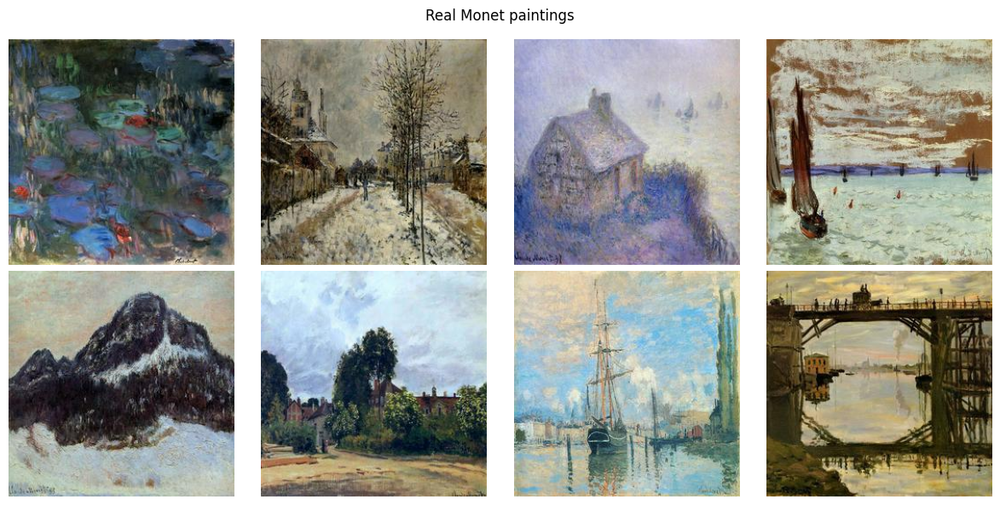

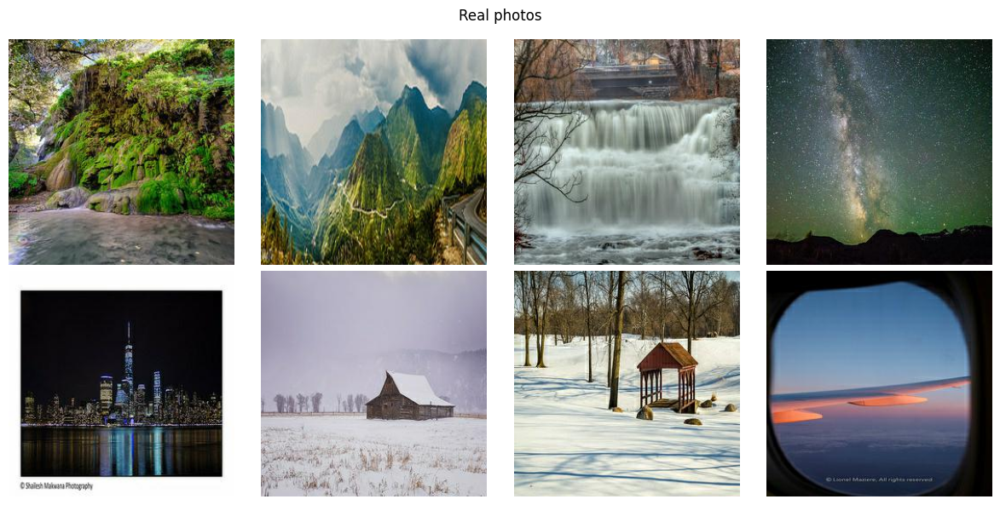

In [ ]:
# Cell 5: Show some real Monet and real photos

def show_random_grid(root: Path, title: str, n: int = 8):
    files = sorted(list(root.glob("*.jpg"))) + sorted(list(root.glob("*.png")))
    n = min(n, len(files))
    chosen = random.sample(files, n)
    imgs = [Image.open(p).convert("RGB") for p in chosen]

    rows = 2
    cols = int(np.ceil(n / rows))
    plt.figure(figsize=(3 * cols, 3 * rows))
    for i, img in enumerate(imgs):
        plt.subplot(rows, cols, i+1)
        plt.imshow(img)
        plt.axis("off")
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

show_random_grid(MONET_JPG,  "Real Monet paintings", n=8)
show_random_grid(PHOTO_JPG,  "Real photos",         n=8)


In [ ]:
# Cell 6: Dataset & DataLoader for CycleGAN

CYC_IMG_SIZE = IMG_SIZE

cyc_train_t = T.Compose([
    T.Resize(int(CYC_IMG_SIZE * 1.12)),    # 256 -> ~286
    T.RandomCrop(CYC_IMG_SIZE),
    T.RandomHorizontalFlip(p=0.5),
    T.ToTensor(),
    T.Normalize([0.5]*3, [0.5]*3),         # [-1, 1]
])

cyc_infer_t = T.Compose([
    T.Resize((CYC_IMG_SIZE, CYC_IMG_SIZE)),
    T.ToTensor(),
    T.Normalize([0.5]*3, [0.5]*3),
])

class MonetPhotoDataset(Dataset):
    """
    Returns (real_photo, real_monet) as tensors in [-1,1].
    Length = max(len(photo_set), len(monet_set)).
    """
    def __init__(self, monet_root, photo_root, transform):
        self.monet_paths = sorted(list(monet_root.glob("*.jpg")))
        self.photo_paths = sorted(list(photo_root.glob("*.jpg")))
        assert len(self.monet_paths) > 0, "No Monet images found!"
        assert len(self.photo_paths) > 0, "No photo images found!"
        self.transform = transform

    def __len__(self):
        return max(len(self.monet_paths), len(self.photo_paths))

    def __getitem__(self, idx):
        monet_path = self.monet_paths[idx % len(self.monet_paths)]
        photo_path = self.photo_paths[idx % len(self.photo_paths)]

        monet = Image.open(monet_path).convert("RGB")
        photo = Image.open(photo_path).convert("RGB")

        monet_t = self.transform(monet)
        photo_t = self.transform(photo)
        return photo_t, monet_t  # (P, M)

cyc_train_ds = MonetPhotoDataset(MONET_JPG, PHOTO_JPG, cyc_train_t)
cyc_train_loader = DataLoader(
    cyc_train_ds,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=2,
    pin_memory=(device.type == "cuda"),
)

print("CycleGAN training dataset length:", len(cyc_train_ds))
print("Monet count:", len(cyc_train_ds.monet_paths),
      "| Photo count:", len(cyc_train_ds.photo_paths))

# quick sanity check
photo_batch, monet_batch = next(iter(cyc_train_loader))
print("Photo batch:", photo_batch.shape, "range:", (photo_batch.min().item(), photo_batch.max().item()))
print("Monet batch:", monet_batch.shape, "range:", (monet_batch.min().item(), monet_batch.max().item()))


CycleGAN training dataset length: 7038
Monet count: 300 | Photo count: 7038
Photo batch: torch.Size([1, 3, 256, 256]) range: (-1.0, 1.0)
Monet batch: torch.Size([1, 3, 256, 256]) range: (-1.0, 0.9921568632125854)


In [ ]:
# Cell 7: ResNet generators & PatchGAN discriminators

class ResNetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, kernel_size=3),
            nn.InstanceNorm2d(dim),
            nn.ReLU(True),

            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, kernel_size=3),
            nn.InstanceNorm2d(dim),
            nn.InstanceNorm2d(dim),
        )

    def forward(self, x):
        return x + self.block(x)


class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=9):
        super().__init__()
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(input_nc, ngf, kernel_size=7),
            nn.InstanceNorm2d(ngf),
            nn.ReLU(True)
        ]

        # Downsample (2 layers: 64->128->256)
        in_features = ngf
        out_features = in_features * 2
        for _ in range(2):
            model += [
                nn.Conv2d(in_features, out_features, 3, 2, 1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(True)
            ]
            in_features = out_features
            out_features *= 2

        # ResNet blocks (9 blocks at 256 channels by default)
        for _ in range(n_blocks):
            model += [ResNetBlock(in_features)]

        # Upsample (2 layers: 256->128->64)
        out_features = in_features // 2
        for _ in range(2):
            model += [
                nn.ConvTranspose2d(in_features, out_features, 3, 2, 1, 1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(True)
            ]
            in_features = out_features
            out_features //= 2

        model += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(in_features, output_nc, kernel_size=7),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)


class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw = 4
        padw = 1

        sequence = [
            nn.Conv2d(input_nc, ndf, kernel_size=kw, stride=2, padding=padw),
            nn.LeakyReLU(0.2, True)
        ]

        nf_mult = 1
        nf_mult_prev = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult
            nf_mult = min(2**n, 8)
            sequence += [
                nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult,
                          kernel_size=kw, stride=2, padding=padw),
                nn.InstanceNorm2d(ndf * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]

        sequence += [
            nn.Conv2d(ndf * nf_mult, 1, kernel_size=kw, stride=1, padding=padw)
        ]

        self.model = nn.Sequential(*sequence)

    def forward(self, x):
        return self.model(x)


## CycleGAN Model Architecture  
We build two generators and two discriminators:

- **G_B**: Photo → Monet  
- **G_A**: Monet → Photo  
- **D_M**: Discriminator for Monet domain  
- **D_P**: Discriminator for Photo domain  

The generators use a ResNet-based architecture, while the discriminators use PatchGAN.  
This setup allows the model to focus on local textures and brushstroke-like details.

In [ ]:
# Cell 8: Create models & optimizers

G_A = ResNetGenerator().to(device)      # Monet -> Photo
G_B = ResNetGenerator().to(device)      # Photo -> Monet
D_M = NLayerDiscriminator().to(device)  # Monet discriminator
D_P = NLayerDiscriminator().to(device)  # Photo discriminator

print("G_A params:", sum(p.numel() for p in G_A.parameters()))
print("G_B params:", sum(p.numel() for p in G_B.parameters()))
print("D_M params:", sum(p.numel() for p in D_M.parameters()))
print("D_P params:", sum(p.numel() for p in D_P.parameters()))

# Losses
criterion_GAN    = nn.MSELoss()
criterion_cycle  = nn.L1Loss()
criterion_idt    = nn.L1Loss()

# Optimizers
lr = 2e-4
beta1 = 0.5
opt_G = torch.optim.Adam(
    list(G_A.parameters()) + list(G_B.parameters()),
    lr=lr, betas=(beta1, 0.999)
)
opt_D_M = torch.optim.Adam(D_M.parameters(), lr=lr, betas=(beta1, 0.999))
opt_D_P = torch.optim.Adam(D_P.parameters(), lr=lr, betas=(beta1, 0.999))

print("Models and optimizers ready on:", device)


G_A params: 11378179
G_B params: 11378179
D_M params: 662977
D_P params: 662977
Models and optimizers ready on: cuda


In [ ]:
# Cell 9: Replay buffer & helper functions

class ReplayBuffer:
    """Buffer of previously generated images for discriminator stability."""
    def __init__(self, max_size=50):
        self.max_size = max_size
        self.data = []

    def push_and_pop(self, data):
        result = []
        for img in data.detach():
            img = img.unsqueeze(0)
            if len(self.data) < self.max_size:
                self.data.append(img)
                result.append(img)
            else:
                if random.random() > 0.5:
                    idx = random.randrange(0, self.max_size)
                    tmp = self.data[idx].clone()
                    self.data[idx] = img
                    result.append(tmp)
                else:
                    result.append(img)
        return torch.cat(result, 0)

fake_M_buffer = ReplayBuffer()
fake_P_buffer = ReplayBuffer()

def denorm(x):
    """[-1,1] -> [0,1]"""
    return (x * 0.5) + 0.5

def save_sample_images(epoch, G_B, loader, device, max_images=8):
    G_B.eval()
    photos, monets = next(iter(loader))
    photos = photos.to(device)
    with torch.no_grad():
        fake_monet = G_B(photos)
    G_B.train()

    out_dir = SAMPLES_DIR / "cyclegan"
    out_dir.mkdir(parents=True, exist_ok=True)
    grid_real = vutils.make_grid(denorm(photos[:max_images]).cpu(), nrow=4)
    grid_fake = vutils.make_grid(denorm(fake_monet[:max_images]).cpu(), nrow=4)

    plt.figure(figsize=(8, 8))
    plt.imshow(np.transpose(grid_real.numpy(), (1, 2, 0)))
    plt.axis("off")
    plt.title(f"Real photos (epoch {epoch})")
    plt.show()

    plt.figure(figsize=(8, 8))
    plt.imshow(np.transpose(grid_fake.numpy(), (1, 2, 0)))
    plt.axis("off")
    plt.title(f"Fake Monet (epoch {epoch})")
    plt.show()

    vutils.save_image(denorm(fake_monet[:max_images]).cpu(),
                      out_dir / f"fake_monet_epoch_{epoch:03d}.png",
                      nrow=4)


##  Training Loop  
CycleGAN training alternates between:

1. **Generator updates**  
   - Fool the discriminators  
   - Preserve content through cycle consistency  
   - Maintain style through identity loss  

2. **Discriminator updates**  
   - Learn to distinguish real from generated images  

The training is adversarial and sometimes unstable, so we monitor images and losses throughout training.



=== Epoch 1/10 starting ===
[Epoch 1/10] step 1/7038 | G: 7.906 | D: 0.959
[Epoch 1/10] step 200/7038 | G: 4.463 | D: 0.222
[Epoch 1/10] step 400/7038 | G: 3.473 | D: 0.194
[Epoch 1/10] step 600/7038 | G: 4.659 | D: 0.134
[Epoch 1/10] step 800/7038 | G: 4.359 | D: 0.126
[Epoch 1/10] step 1000/7038 | G: 4.352 | D: 0.229
[Epoch 1/10] step 1200/7038 | G: 4.601 | D: 0.219
[Epoch 1/10] step 1400/7038 | G: 4.508 | D: 0.100
[Epoch 1/10] step 1600/7038 | G: 2.905 | D: 0.238
[Epoch 1/10] step 1800/7038 | G: 3.569 | D: 0.152
[Epoch 1/10] step 2000/7038 | G: 3.587 | D: 0.420
[Epoch 1/10] step 2200/7038 | G: 5.439 | D: 0.220
[Epoch 1/10] step 2400/7038 | G: 4.325 | D: 0.186
[Epoch 1/10] step 2600/7038 | G: 3.250 | D: 0.179
[Epoch 1/10] step 2800/7038 | G: 4.862 | D: 0.094
[Epoch 1/10] step 3000/7038 | G: 3.668 | D: 0.206
[Epoch 1/10] step 3200/7038 | G: 2.775 | D: 0.138
[Epoch 1/10] step 3400/7038 | G: 2.941 | D: 0.169
[Epoch 1/10] step 3600/7038 | G: 3.534 | D: 0.176
[Epoch 1/10] step 3800/7038 

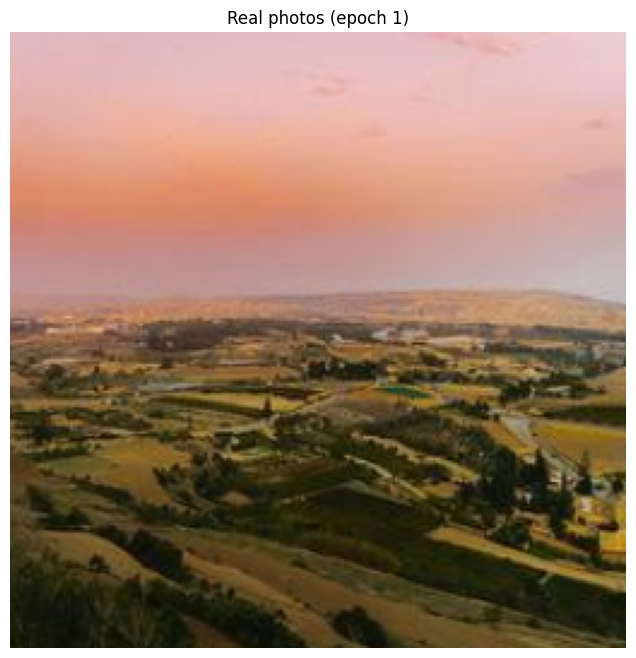

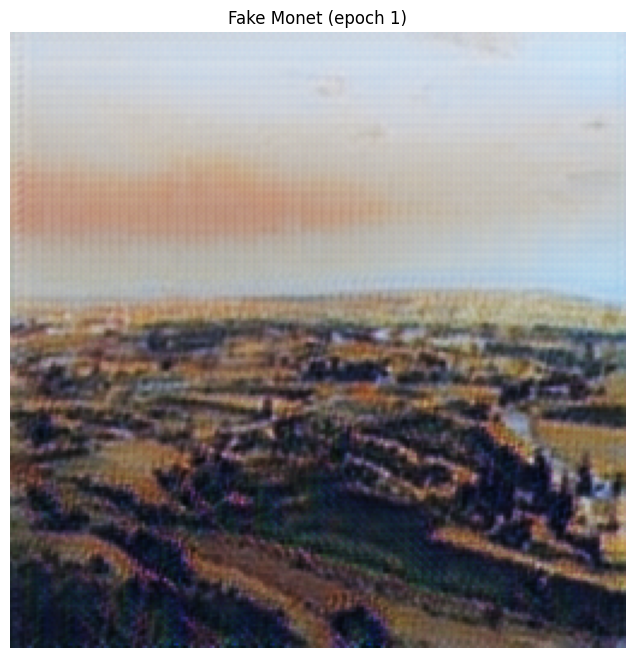


=== Epoch 2/10 starting ===
[Epoch 2/10] step 1/7038 | G: 5.657 | D: 0.110
[Epoch 2/10] step 200/7038 | G: 2.433 | D: 0.118
[Epoch 2/10] step 400/7038 | G: 3.429 | D: 0.423
[Epoch 2/10] step 600/7038 | G: 3.011 | D: 0.134
[Epoch 2/10] step 800/7038 | G: 2.148 | D: 0.217
[Epoch 2/10] step 1000/7038 | G: 2.630 | D: 0.138
[Epoch 2/10] step 1200/7038 | G: 5.193 | D: 0.147
[Epoch 2/10] step 1400/7038 | G: 4.741 | D: 0.070
[Epoch 2/10] step 1600/7038 | G: 3.262 | D: 0.135
[Epoch 2/10] step 1800/7038 | G: 4.945 | D: 0.139
[Epoch 2/10] step 2000/7038 | G: 3.719 | D: 0.127
[Epoch 2/10] step 2200/7038 | G: 3.879 | D: 0.366
[Epoch 2/10] step 2400/7038 | G: 2.213 | D: 0.089
[Epoch 2/10] step 2600/7038 | G: 3.324 | D: 0.143
[Epoch 2/10] step 2800/7038 | G: 2.125 | D: 0.163
[Epoch 2/10] step 3000/7038 | G: 2.828 | D: 0.185
[Epoch 2/10] step 3200/7038 | G: 2.700 | D: 0.178
[Epoch 2/10] step 3400/7038 | G: 2.866 | D: 0.128
[Epoch 2/10] step 3600/7038 | G: 2.504 | D: 0.220
[Epoch 2/10] step 3800/7038 

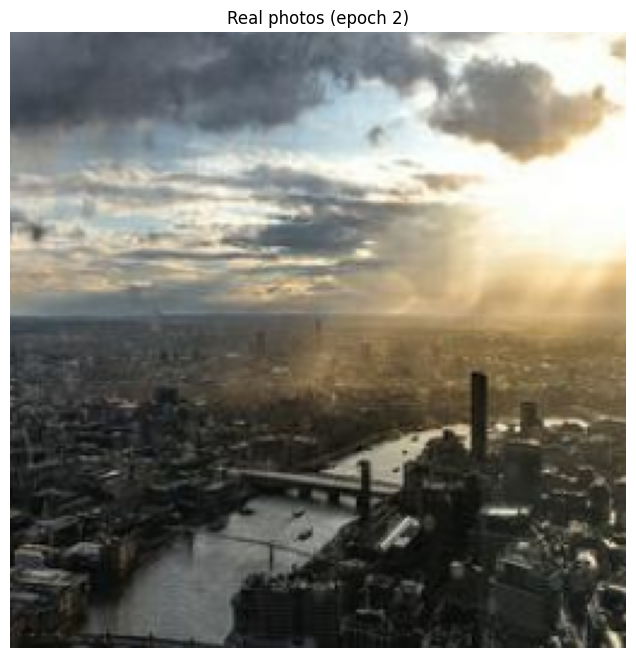

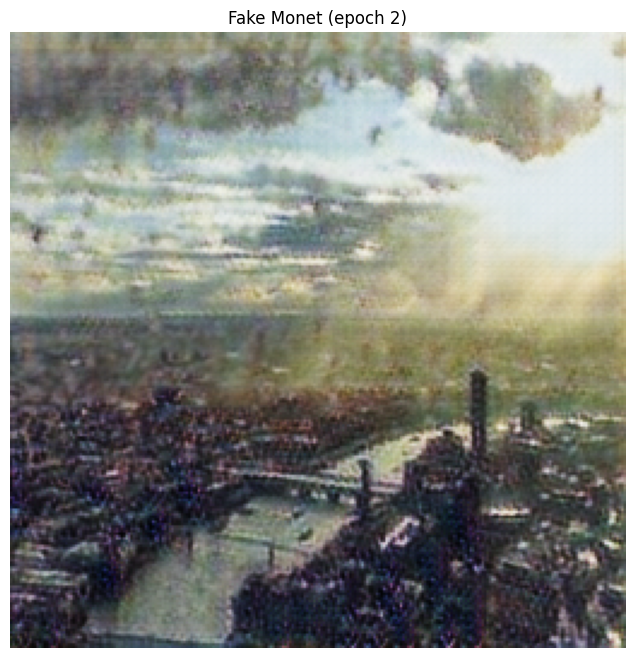


=== Epoch 3/10 starting ===
[Epoch 3/10] step 1/7038 | G: 2.122 | D: 0.159
[Epoch 3/10] step 200/7038 | G: 2.210 | D: 0.169
[Epoch 3/10] step 400/7038 | G: 2.973 | D: 0.126
[Epoch 3/10] step 600/7038 | G: 2.216 | D: 0.103
[Epoch 3/10] step 800/7038 | G: 2.601 | D: 0.217
[Epoch 3/10] step 1000/7038 | G: 3.201 | D: 0.183
[Epoch 3/10] step 1200/7038 | G: 2.505 | D: 0.153
[Epoch 3/10] step 1400/7038 | G: 2.192 | D: 0.132
[Epoch 3/10] step 1600/7038 | G: 2.254 | D: 0.097
[Epoch 3/10] step 1800/7038 | G: 2.239 | D: 0.122
[Epoch 3/10] step 2000/7038 | G: 2.395 | D: 0.202
[Epoch 3/10] step 2200/7038 | G: 2.815 | D: 0.171
[Epoch 3/10] step 2400/7038 | G: 2.542 | D: 0.197
[Epoch 3/10] step 2600/7038 | G: 1.925 | D: 0.172
[Epoch 3/10] step 2800/7038 | G: 2.109 | D: 0.131
[Epoch 3/10] step 3000/7038 | G: 3.145 | D: 0.159
[Epoch 3/10] step 3200/7038 | G: 2.630 | D: 0.143
[Epoch 3/10] step 3400/7038 | G: 2.873 | D: 0.083
[Epoch 3/10] step 3600/7038 | G: 1.758 | D: 0.349
[Epoch 3/10] step 3800/7038 

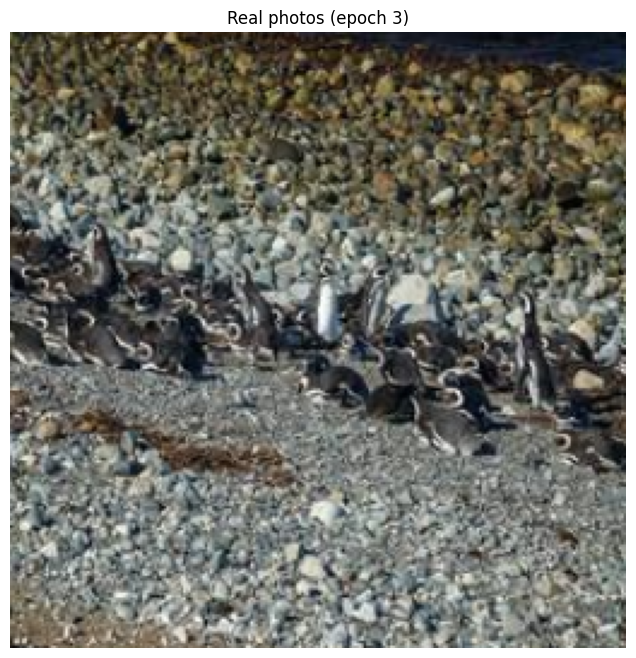

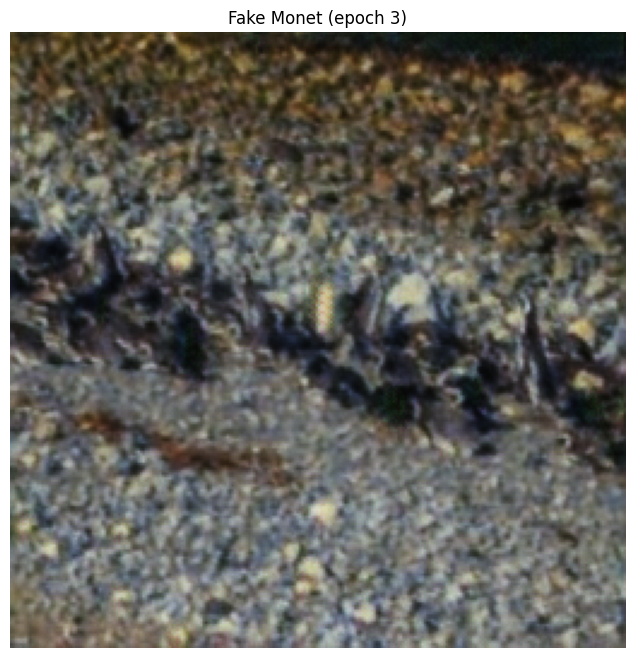


=== Epoch 4/10 starting ===
[Epoch 4/10] step 1/7038 | G: 1.936 | D: 0.261
[Epoch 4/10] step 200/7038 | G: 2.441 | D: 0.109
[Epoch 4/10] step 400/7038 | G: 2.751 | D: 0.145
[Epoch 4/10] step 600/7038 | G: 2.534 | D: 0.097
[Epoch 4/10] step 800/7038 | G: 2.354 | D: 0.244
[Epoch 4/10] step 1000/7038 | G: 2.223 | D: 0.176
[Epoch 4/10] step 1200/7038 | G: 2.297 | D: 0.243
[Epoch 4/10] step 1400/7038 | G: 2.643 | D: 0.191
[Epoch 4/10] step 1600/7038 | G: 1.726 | D: 0.235
[Epoch 4/10] step 1800/7038 | G: 1.879 | D: 0.060
[Epoch 4/10] step 2000/7038 | G: 2.555 | D: 0.137
[Epoch 4/10] step 2200/7038 | G: 2.817 | D: 0.171
[Epoch 4/10] step 2400/7038 | G: 2.058 | D: 0.312
[Epoch 4/10] step 2600/7038 | G: 2.734 | D: 0.369
[Epoch 4/10] step 2800/7038 | G: 2.681 | D: 0.176
[Epoch 4/10] step 3000/7038 | G: 2.730 | D: 0.161
[Epoch 4/10] step 3200/7038 | G: 3.595 | D: 0.107
[Epoch 4/10] step 3400/7038 | G: 1.892 | D: 0.223
[Epoch 4/10] step 3600/7038 | G: 2.505 | D: 0.244
[Epoch 4/10] step 3800/7038 

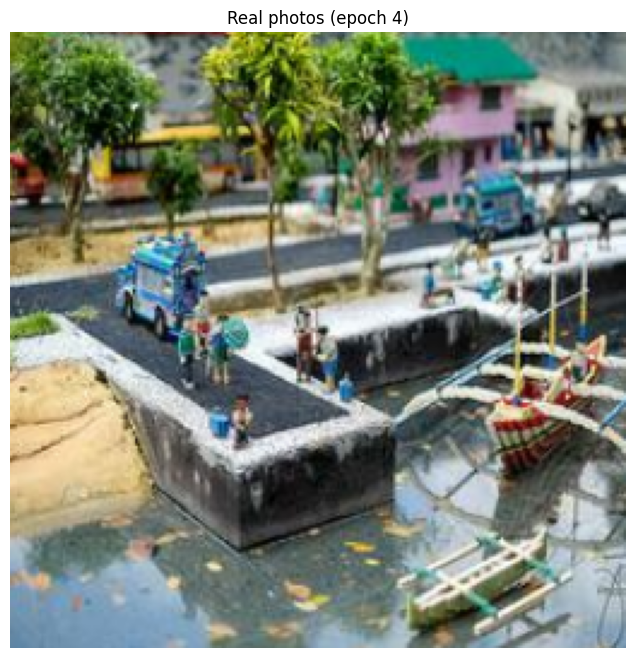

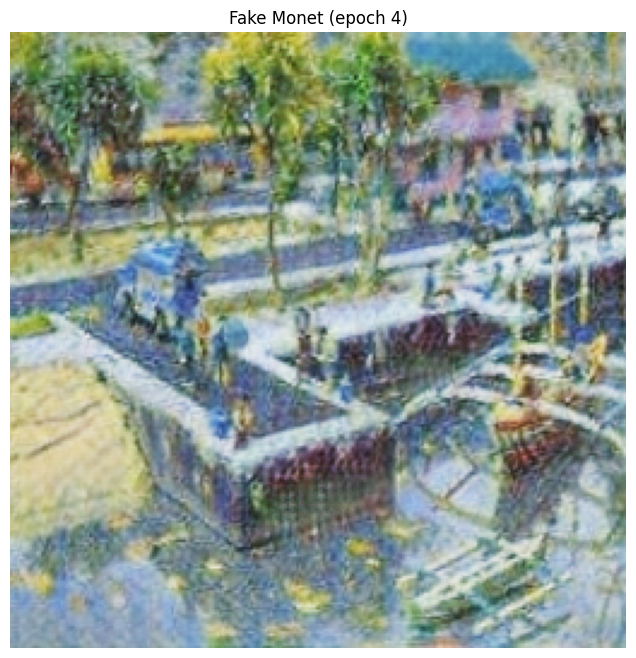


=== Epoch 5/10 starting ===
[Epoch 5/10] step 1/7038 | G: 2.887 | D: 0.079
[Epoch 5/10] step 200/7038 | G: 1.747 | D: 0.199
[Epoch 5/10] step 400/7038 | G: 2.217 | D: 0.089
[Epoch 5/10] step 600/7038 | G: 3.026 | D: 0.287
[Epoch 5/10] step 800/7038 | G: 1.810 | D: 0.190
[Epoch 5/10] step 1000/7038 | G: 2.047 | D: 0.111
[Epoch 5/10] step 1200/7038 | G: 3.124 | D: 0.110
[Epoch 5/10] step 1400/7038 | G: 3.236 | D: 0.211
[Epoch 5/10] step 1600/7038 | G: 2.208 | D: 0.188
[Epoch 5/10] step 1800/7038 | G: 1.427 | D: 0.123
[Epoch 5/10] step 2000/7038 | G: 2.916 | D: 0.113
[Epoch 5/10] step 2200/7038 | G: 2.332 | D: 0.147
[Epoch 5/10] step 2400/7038 | G: 2.946 | D: 0.244
[Epoch 5/10] step 2600/7038 | G: 2.213 | D: 0.050
[Epoch 5/10] step 2800/7038 | G: 1.714 | D: 0.095
[Epoch 5/10] step 3000/7038 | G: 2.566 | D: 0.132
[Epoch 5/10] step 3200/7038 | G: 2.600 | D: 0.185
[Epoch 5/10] step 3400/7038 | G: 1.939 | D: 0.281
[Epoch 5/10] step 3600/7038 | G: 2.765 | D: 0.122
[Epoch 5/10] step 3800/7038 

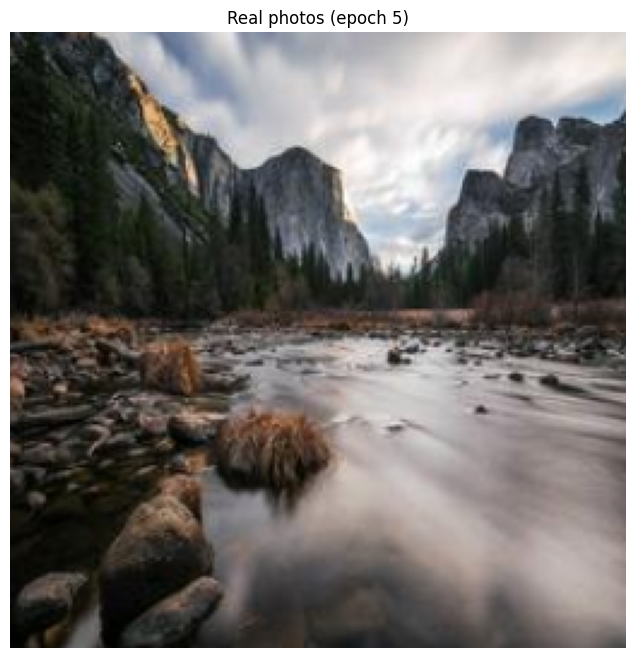

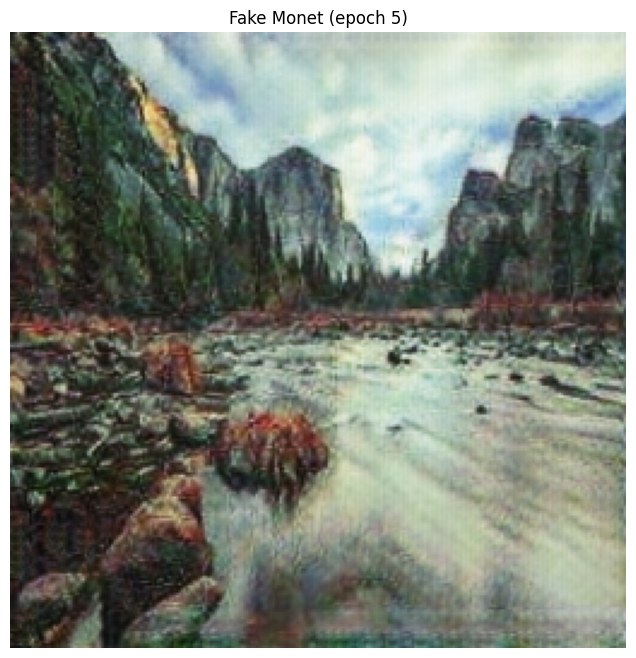


=== Epoch 6/10 starting ===
[Epoch 6/10] step 1/7038 | G: 1.695 | D: 0.179
[Epoch 6/10] step 200/7038 | G: 2.019 | D: 0.224
[Epoch 6/10] step 400/7038 | G: 1.852 | D: 0.118
[Epoch 6/10] step 600/7038 | G: 1.256 | D: 0.191
[Epoch 6/10] step 800/7038 | G: 1.641 | D: 0.190
[Epoch 6/10] step 1000/7038 | G: 1.637 | D: 0.242
[Epoch 6/10] step 1200/7038 | G: 2.534 | D: 0.244
[Epoch 6/10] step 1400/7038 | G: 1.788 | D: 0.253
[Epoch 6/10] step 1600/7038 | G: 2.227 | D: 0.057
[Epoch 6/10] step 1800/7038 | G: 2.242 | D: 0.136
[Epoch 6/10] step 2000/7038 | G: 2.008 | D: 0.258
[Epoch 6/10] step 2200/7038 | G: 2.084 | D: 0.090
[Epoch 6/10] step 2400/7038 | G: 3.158 | D: 0.158
[Epoch 6/10] step 2600/7038 | G: 1.888 | D: 0.131
[Epoch 6/10] step 2800/7038 | G: 1.703 | D: 0.151
[Epoch 6/10] step 3000/7038 | G: 1.965 | D: 0.292
[Epoch 6/10] step 3200/7038 | G: 2.130 | D: 0.153
[Epoch 6/10] step 3400/7038 | G: 1.721 | D: 0.163
[Epoch 6/10] step 3600/7038 | G: 1.598 | D: 0.138
[Epoch 6/10] step 3800/7038 

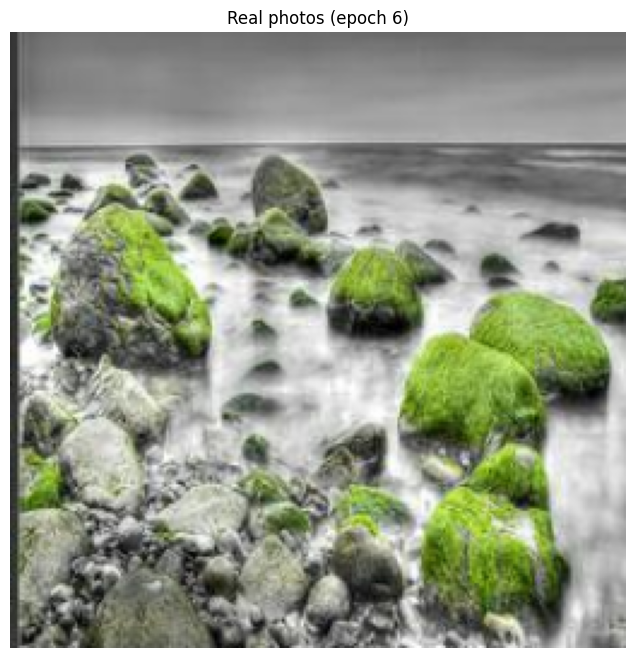

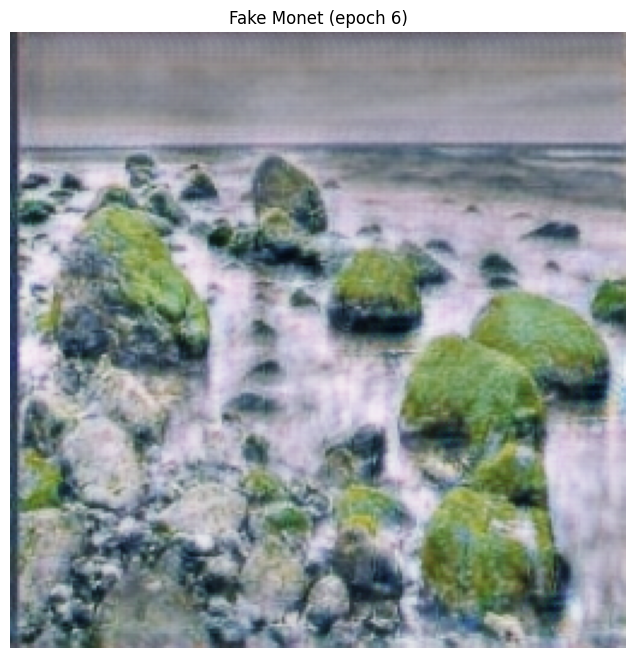


=== Epoch 7/10 starting ===
[Epoch 7/10] step 1/7038 | G: 2.316 | D: 0.223
[Epoch 7/10] step 200/7038 | G: 2.336 | D: 0.119
[Epoch 7/10] step 400/7038 | G: 2.477 | D: 0.086
[Epoch 7/10] step 600/7038 | G: 2.211 | D: 0.139
[Epoch 7/10] step 800/7038 | G: 2.304 | D: 0.071
[Epoch 7/10] step 1000/7038 | G: 3.402 | D: 0.099
[Epoch 7/10] step 1200/7038 | G: 1.581 | D: 0.263
[Epoch 7/10] step 1400/7038 | G: 1.364 | D: 0.179
[Epoch 7/10] step 1600/7038 | G: 1.884 | D: 0.174
[Epoch 7/10] step 1800/7038 | G: 2.139 | D: 0.131
[Epoch 7/10] step 2000/7038 | G: 1.995 | D: 0.117
[Epoch 7/10] step 2200/7038 | G: 1.446 | D: 0.171
[Epoch 7/10] step 2400/7038 | G: 2.065 | D: 0.209
[Epoch 7/10] step 2600/7038 | G: 1.665 | D: 0.149
[Epoch 7/10] step 2800/7038 | G: 2.432 | D: 0.188
[Epoch 7/10] step 3000/7038 | G: 2.713 | D: 0.151
[Epoch 7/10] step 3200/7038 | G: 1.727 | D: 0.218
[Epoch 7/10] step 3400/7038 | G: 1.968 | D: 0.110
[Epoch 7/10] step 3600/7038 | G: 1.316 | D: 0.181
[Epoch 7/10] step 3800/7038 

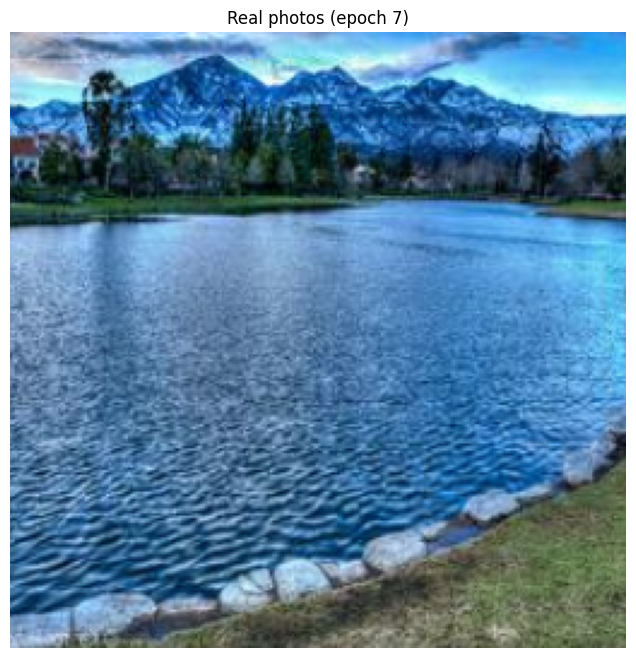

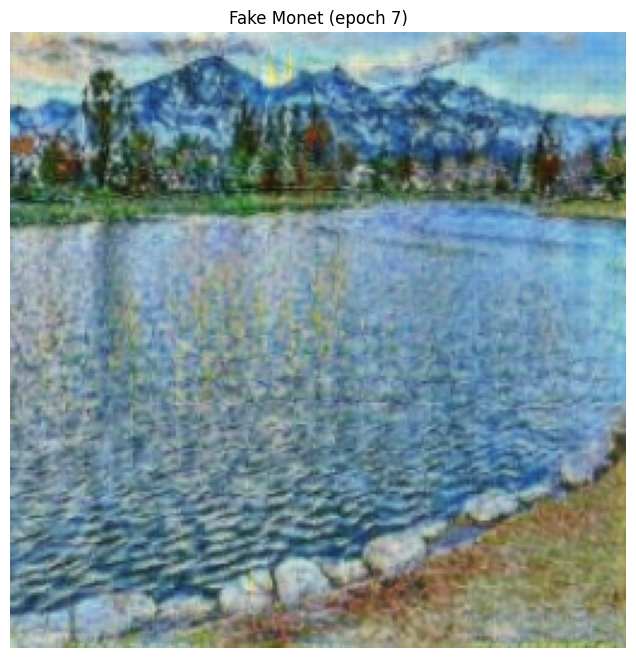


=== Epoch 8/10 starting ===
[Epoch 8/10] step 1/7038 | G: 2.185 | D: 0.149
[Epoch 8/10] step 200/7038 | G: 1.678 | D: 0.107
[Epoch 8/10] step 400/7038 | G: 2.414 | D: 0.192
[Epoch 8/10] step 600/7038 | G: 1.598 | D: 0.065
[Epoch 8/10] step 800/7038 | G: 2.015 | D: 0.083
[Epoch 8/10] step 1000/7038 | G: 2.630 | D: 0.203
[Epoch 8/10] step 1200/7038 | G: 2.267 | D: 0.139
[Epoch 8/10] step 1400/7038 | G: 2.368 | D: 0.223
[Epoch 8/10] step 1600/7038 | G: 1.718 | D: 0.152
[Epoch 8/10] step 1800/7038 | G: 2.576 | D: 0.145
[Epoch 8/10] step 2000/7038 | G: 1.714 | D: 0.241
[Epoch 8/10] step 2200/7038 | G: 2.125 | D: 0.152
[Epoch 8/10] step 2400/7038 | G: 2.605 | D: 0.119
[Epoch 8/10] step 2600/7038 | G: 1.758 | D: 0.203
[Epoch 8/10] step 2800/7038 | G: 2.495 | D: 0.081
[Epoch 8/10] step 3000/7038 | G: 1.645 | D: 0.092
[Epoch 8/10] step 3200/7038 | G: 2.432 | D: 0.170
[Epoch 8/10] step 3400/7038 | G: 1.904 | D: 0.138
[Epoch 8/10] step 3600/7038 | G: 2.157 | D: 0.221
[Epoch 8/10] step 3800/7038 

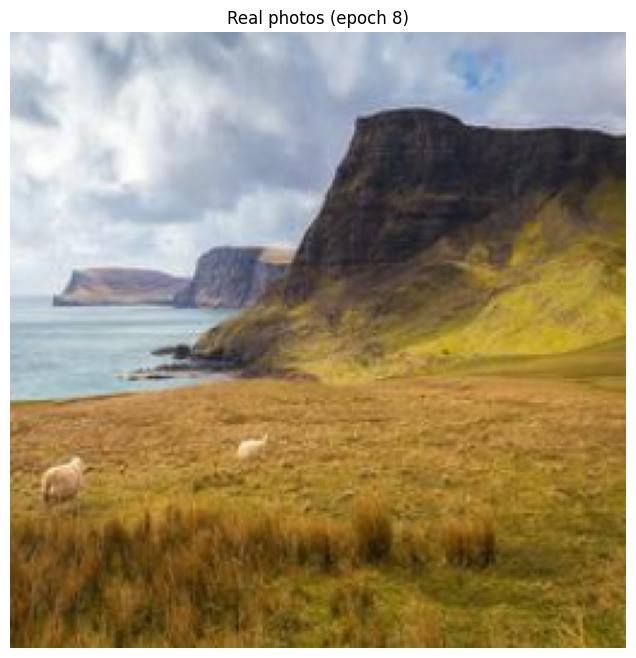

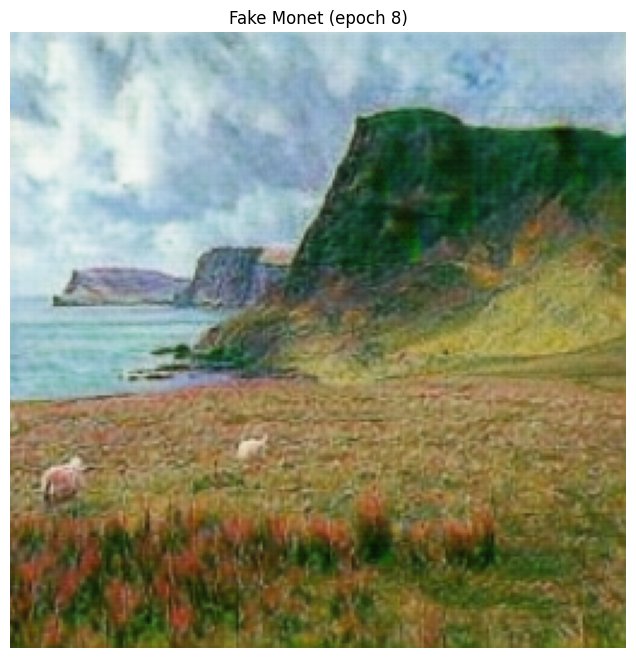


=== Epoch 9/10 starting ===
[Epoch 9/10] step 1/7038 | G: 1.992 | D: 0.189
[Epoch 9/10] step 200/7038 | G: 1.712 | D: 0.192
[Epoch 9/10] step 400/7038 | G: 1.880 | D: 0.104
[Epoch 9/10] step 600/7038 | G: 1.525 | D: 0.156
[Epoch 9/10] step 800/7038 | G: 2.363 | D: 0.207
[Epoch 9/10] step 1000/7038 | G: 2.480 | D: 0.154
[Epoch 9/10] step 1200/7038 | G: 2.304 | D: 0.109
[Epoch 9/10] step 1400/7038 | G: 2.815 | D: 0.054
[Epoch 9/10] step 1600/7038 | G: 1.725 | D: 0.179
[Epoch 9/10] step 1800/7038 | G: 1.685 | D: 0.169
[Epoch 9/10] step 2000/7038 | G: 2.452 | D: 0.090
[Epoch 9/10] step 2200/7038 | G: 1.737 | D: 0.179
[Epoch 9/10] step 2400/7038 | G: 1.702 | D: 0.109
[Epoch 9/10] step 2600/7038 | G: 1.939 | D: 0.192
[Epoch 9/10] step 2800/7038 | G: 1.922 | D: 0.215
[Epoch 9/10] step 3000/7038 | G: 2.760 | D: 0.176
[Epoch 9/10] step 3200/7038 | G: 1.963 | D: 0.156
[Epoch 9/10] step 3400/7038 | G: 1.571 | D: 0.110
[Epoch 9/10] step 3600/7038 | G: 3.320 | D: 0.108
[Epoch 9/10] step 3800/7038 

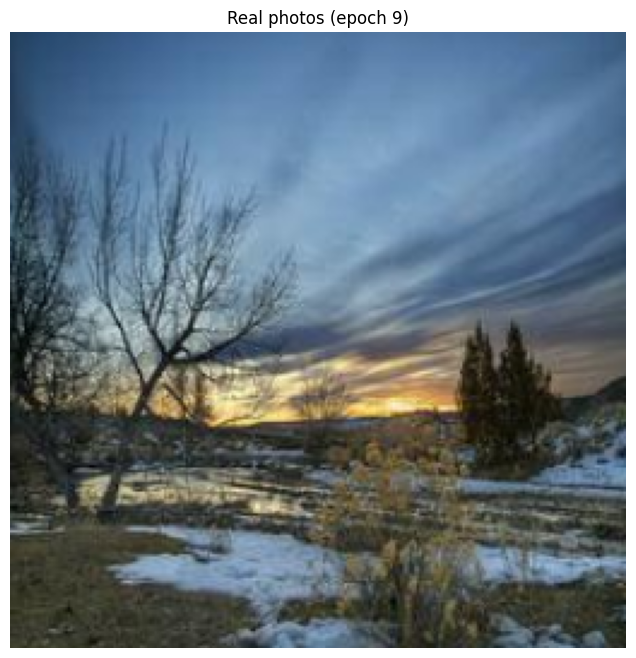

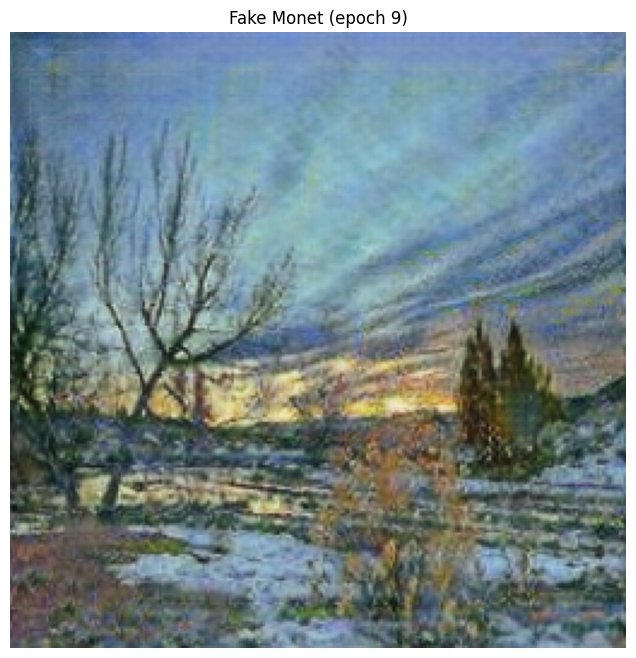


=== Epoch 10/10 starting ===
[Epoch 10/10] step 1/7038 | G: 1.553 | D: 0.211
[Epoch 10/10] step 200/7038 | G: 2.140 | D: 0.299
[Epoch 10/10] step 400/7038 | G: 2.304 | D: 0.133
[Epoch 10/10] step 600/7038 | G: 2.325 | D: 0.244
[Epoch 10/10] step 800/7038 | G: 1.886 | D: 0.169
[Epoch 10/10] step 1000/7038 | G: 1.833 | D: 0.186
[Epoch 10/10] step 1200/7038 | G: 2.461 | D: 0.131
[Epoch 10/10] step 1400/7038 | G: 1.548 | D: 0.275
[Epoch 10/10] step 1600/7038 | G: 1.987 | D: 0.154
[Epoch 10/10] step 1800/7038 | G: 2.193 | D: 0.225
[Epoch 10/10] step 2000/7038 | G: 1.935 | D: 0.302
[Epoch 10/10] step 2200/7038 | G: 1.564 | D: 0.172
[Epoch 10/10] step 2400/7038 | G: 2.284 | D: 0.260
[Epoch 10/10] step 2600/7038 | G: 1.894 | D: 0.109
[Epoch 10/10] step 2800/7038 | G: 1.742 | D: 0.241
[Epoch 10/10] step 3000/7038 | G: 2.084 | D: 0.219
[Epoch 10/10] step 3200/7038 | G: 1.857 | D: 0.123
[Epoch 10/10] step 3400/7038 | G: 2.096 | D: 0.063
[Epoch 10/10] step 3600/7038 | G: 1.915 | D: 0.164
[Epoch 1

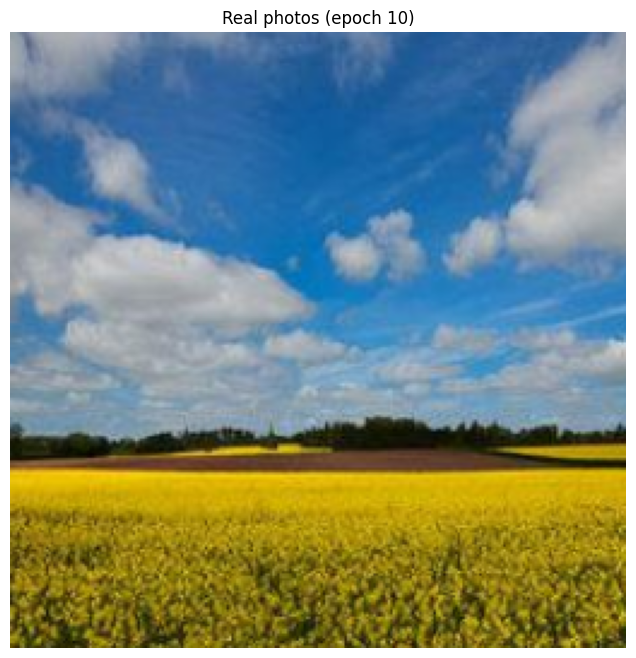

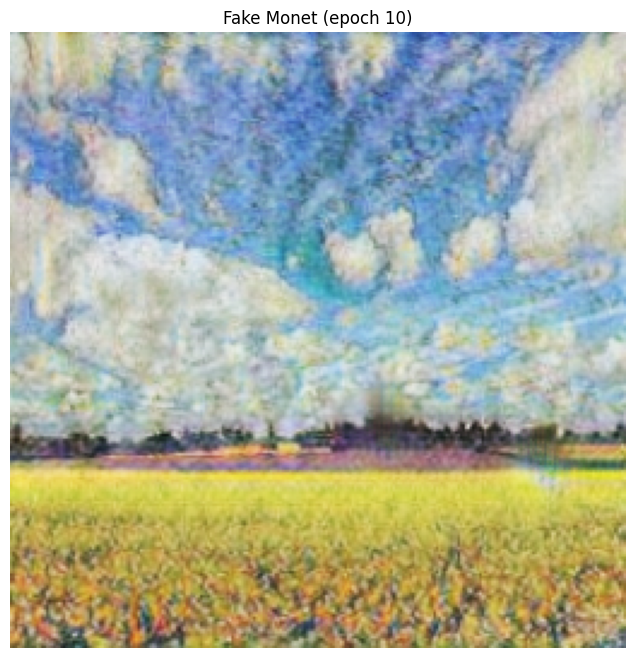

✅ CycleGAN GPU training finished.


In [ ]:
# Cell 10: Training loop (CycleGAN, GPU-friendly, dynamic label shapes)

def train_cyclegan(num_epochs=CYCLEGAN_EPOCHS):
    G_A.train()
    G_B.train()
    D_M.train()
    D_P.train()

    global_step = 0
    for epoch in range(1, num_epochs + 1):
        start = time.time()
        g_loss_running = 0.0
        d_loss_running = 0.0

        print(f"\n=== Epoch {epoch}/{num_epochs} starting ===")
        for i, (real_P, real_M) in enumerate(cyc_train_loader, start=1):
            real_P = real_P.to(device)  # photos
            real_M = real_M.to(device)  # Monet
            bs = real_P.size(0)

            # ----------------------
            #  Train Generators (G_A, G_B)
            # ----------------------
            opt_G.zero_grad()

            # Identity loss
            idt_M = G_B(real_M)
            loss_idt_M = criterion_idt(idt_M, real_M) * LAMBDA_IDT

            idt_P = G_A(real_P)
            loss_idt_P = criterion_idt(idt_P, real_P) * LAMBDA_IDT

            loss_idt = (loss_idt_M + loss_idt_P) * 0.5

            # GAN loss (Photo -> Monet)
            fake_M = G_B(real_P)
            pred_fake_M = D_M(fake_M)
            valid_M_for_G = torch.ones_like(pred_fake_M)
            loss_GAN_P2M = criterion_GAN(pred_fake_M, valid_M_for_G)

            # GAN loss (Monet -> Photo)
            fake_P = G_A(real_M)
            pred_fake_P = D_P(fake_P)
            valid_P_for_G = torch.ones_like(pred_fake_P)
            loss_GAN_M2P = criterion_GAN(pred_fake_P, valid_P_for_G)

            loss_GAN = (loss_GAN_P2M + loss_GAN_M2P) * 0.5

            # Cycle-consistency loss
            rec_P = G_A(fake_M)
            loss_cycle_P = criterion_cycle(rec_P, real_P)

            rec_M = G_B(fake_P)
            loss_cycle_M = criterion_cycle(rec_M, real_M)

            loss_cycle = (loss_cycle_P + loss_cycle_M) * 0.5 * LAMBDA_CYCLE

            # Total generator loss
            loss_G = loss_GAN + loss_cycle + loss_idt
            loss_G.backward()
            opt_G.step()

            # ----------------------
            #  Train Discriminator M (Monet)
            # ----------------------
            opt_D_M.zero_grad()

            # Real Monet
            pred_real_M = D_M(real_M)
            valid_M = torch.ones_like(pred_real_M)
            loss_D_real_M = criterion_GAN(pred_real_M, valid_M)

            # Fake Monet (from buffer)
            fake_M_buffered = fake_M_buffer.push_and_pop(fake_M)
            pred_fake_M = D_M(fake_M_buffered.detach())
            fake_M_lbl = torch.zeros_like(pred_fake_M)
            loss_D_fake_M = criterion_GAN(pred_fake_M, fake_M_lbl)

            loss_D_M = (loss_D_real_M + loss_D_fake_M) * 0.5
            loss_D_M.backward()
            opt_D_M.step()

            # ----------------------
            #  Train Discriminator P (Photo)
            # ----------------------
            opt_D_P.zero_grad()

            # Real Photo
            pred_real_P = D_P(real_P)
            valid_P = torch.ones_like(pred_real_P)
            loss_D_real_P = criterion_GAN(pred_real_P, valid_P)

            # Fake Photo (from buffer)
            fake_P_buffered = fake_P_buffer.push_and_pop(fake_P)
            pred_fake_P = D_P(fake_P_buffered.detach())
            fake_P_lbl = torch.zeros_like(pred_fake_P)
            loss_D_fake_P = criterion_GAN(pred_fake_P, fake_P_lbl)

            loss_D_P = (loss_D_real_P + loss_D_fake_P) * 0.5
            loss_D_P.backward()
            opt_D_P.step()

            # Combined D loss
            loss_D = (loss_D_M + loss_D_P) * 0.5

            # Accumulate stats
            g_loss_running += loss_G.item() * bs
            d_loss_running += loss_D.item() * bs
            global_step += bs

            if i % 200 == 0 or i == 1:
                print(
                    f"[Epoch {epoch}/{num_epochs}] step {i}/{len(cyc_train_loader)} "
                    f"| G: {loss_G.item():.3f} | D: {loss_D.item():.3f}"
                )

        # End of epoch
        g_loss_epoch = g_loss_running / len(cyc_train_ds)
        d_loss_epoch = d_loss_running / len(cyc_train_ds)
        elapsed = (time.time() - start) / 60.0

        # Save checkpoint
        ckpt_path = CKPT_DIR / "cyclegan_latest_gpu.pt"
        state = {
            "G_A": G_A.state_dict(),
            "G_B": G_B.state_dict(),
            "D_M": D_M.state_dict(),
            "D_P": D_P.state_dict(),
            "opt_G": opt_G.state_dict(),
            "opt_D_M": opt_D_M.state_dict(),
            "opt_D_P": opt_D_P.state_dict(),
            "epoch": epoch,
        }
        torch.save(state, ckpt_path)
        print(
            f"Saved checkpoint to {ckpt_path} | "
            f"G_epoch: {g_loss_epoch:.3f} | D_epoch: {d_loss_epoch:.3f} "
            f"| time: {elapsed:.1f} min"
        )

        # Visual sample for the epoch
        save_sample_images(epoch, G_B, cyc_train_loader, device)

    print("✅ CycleGAN GPU training finished.")


# Kick off training
train_cyclegan()


## Saving & Loading Checkpoints  
Model checkpoints allow to:

- Resume training  
- Run inference without retraining  
- Generate submission images  

Updates the code to save generator and discriminator weights along with optimizer states and save checkoints. This was crucial because the notebook timed out after long time of no activity on colab and i had to restart several times. This was a painful learning expereince.


In [ ]:
from torchvision.utils import save_image
from PIL import Image
import os

# Make sure `device` and `transform` are the same as in training.

def denorm(t):
    """Convert from [-1, 1] back to [0, 1] for saving."""
    return (t + 1) / 2

def translate_folder(input_folder, output_folder, generator, transform):
    os.makedirs(output_folder, exist_ok=True)

    files = sorted([
        f for f in os.listdir(input_folder)
        if f.lower().endswith((".jpg", ".jpeg", ".png"))
    ])

    print(f"Translating {len(files)} images from {input_folder} → {output_folder}")

    for fname in files:
        in_path = os.path.join(input_folder, fname)

        img = Image.open(in_path).convert("RGB")
        x = transform(img).unsqueeze(0).to(device)

        with torch.no_grad():
            y = generator(x)

        out_path = os.path.join(output_folder, fname)
        save_image(denorm(y), out_path)
        print("Saved:", out_path)


In [ ]:
# Cell 11: Generate monet-style images for submission and zip them

G_B.eval()
gen_dir = PROJECT / "images_cyclegan_gpu"
gen_dir.mkdir(exist_ok=True, parents=True)

photo_files = sorted(list(PHOTO_JPG.glob("*.jpg")))
total_photos = len(photo_files)
print("Total photo files found:", total_photos)

n_gen = min(SUBMISSION_SIZE, total_photos)
print(f"Will generate {n_gen} Monet-style images.")

transform_infer = cyc_infer_t

with torch.no_grad():
    for i, img_path in enumerate(photo_files[:n_gen], start=1):
        img = Image.open(img_path).convert("RGB")
        x = transform_infer(img).unsqueeze(0).to(device)
        fake = G_B(x)
        fake = denorm(fake).clamp(0, 1)
        fake_img = T.ToPILImage()(fake.squeeze(0).cpu())
        out_name = f"image_{i-1}.jpg"  # Kaggle expects numbered files
        fake_img.save(gen_dir / out_name, "JPEG", quality=95)

        if i % 500 == 0 or i == n_gen:
            print(f"Generated {i}/{n_gen} images...")

zip_path = PROJECT / "images_cyclegan_gpu.zip"
if zip_path.exists():
    zip_path.unlink()
shutil.make_archive(zip_path.with_suffix(""), "zip", gen_dir)
print(f"✅ Done. Submission ZIP saved as: {zip_path}")


Total photo files found: 7038
Will generate 7000 Monet-style images.
Generated 500/7000 images...
Generated 1000/7000 images...
Generated 1500/7000 images...
Generated 2000/7000 images...
Generated 2500/7000 images...
Generated 3000/7000 images...
Generated 3500/7000 images...
Generated 4000/7000 images...
Generated 4500/7000 images...
Generated 5000/7000 images...
Generated 5500/7000 images...
Generated 6000/7000 images...
Generated 6500/7000 images...
Generated 7000/7000 images...
✅ Done. Submission ZIP saved as: /content/images_cyclegan_gpu.zip


In [ ]:
# Cell 12: Download submission ZIP to your local machine

from google.colab import files
files.download("/content/images_cyclegan_gpu.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Visual Evaluation of Model Performance  
GANs are best evaluated visually, so we include:

- Real Photo → Monet-style → Real Monet comparison  
- Photo → Monet → Photo cycle consistency  
- Distribution of cycle reconstruction error  

These plots demonstrate both style transfer quality and content preservation.

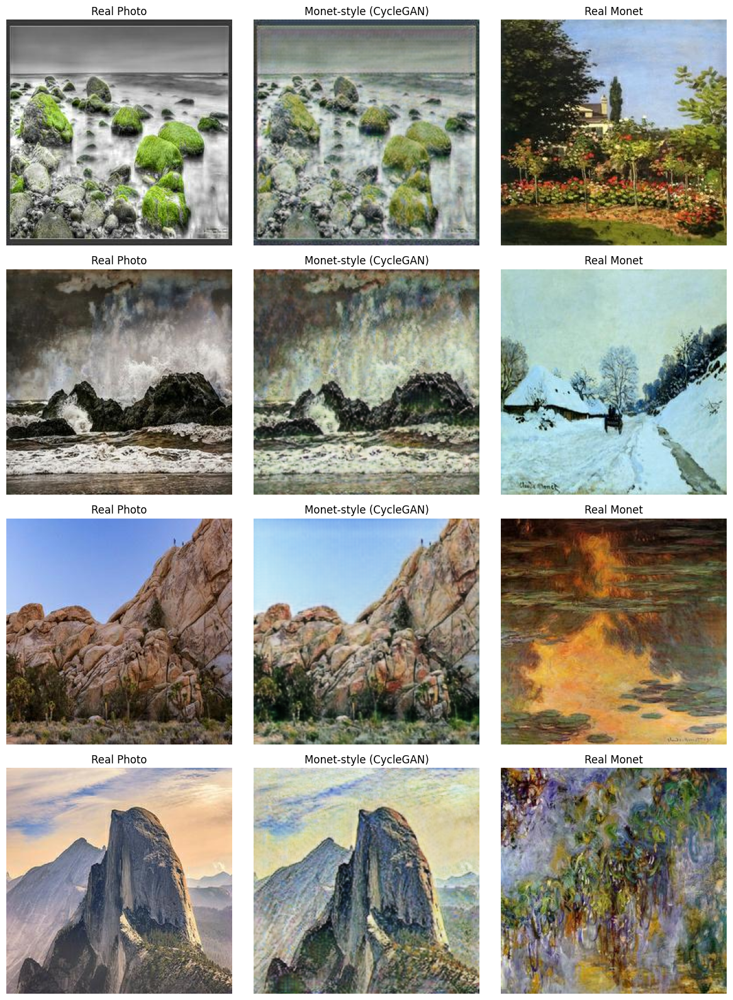

In [ ]:
# Cell 13: Visual comparison – real photo vs Monet-style vs real Monet

def show_photo_to_monet_examples(num_examples=4, reload_checkpoint=False):
    """
    Displays side-by-side:
      - Real photo
      - Monet-style image generated by CycleGAN
      - Real Monet painting

    Args:
        num_examples (int): number of rows to display
        reload_checkpoint (bool): if True, reloads the trained model weights
                                  from the checkpoint before generating images.
    """

    # Optional: reload trained weights (helps keep notebook self-contained)
    if reload_checkpoint:
        ckpt_path = PROJECT / "runs" / "checkpoints" / "cyclegan_latest_gpu.pt"
        print(f"Reloading checkpoint: {ckpt_path}")

        ckpt = torch.load(ckpt_path, map_location=device)
        G_A.load_state_dict(ckpt["G_A"])
        G_B.load_state_dict(ckpt["G_B"])
        D_M.load_state_dict(ckpt["D_M"])
        D_P.load_state_dict(ckpt["D_P"])
        G_A.eval()
        G_B.eval()
        print("✔ Model weights reloaded and generators set to eval mode.")

    else:
        # At minimum ensure eval mode
        G_B.eval()

    # Randomly choose samples
    photo_files = random.sample(cyc_train_ds.photo_paths, num_examples)
    monet_files = random.sample(cyc_train_ds.monet_paths, num_examples)

    plt.figure(figsize=(12, 4 * num_examples))

    for i, (pf, mf) in enumerate(zip(photo_files, monet_files)):
        photo = Image.open(pf).convert("RGB")
        monet = Image.open(mf).convert("RGB")

        # Prepare tensor
        x = cyc_infer_t(photo).unsqueeze(0).to(device)

        with torch.no_grad():
            fake_m = G_B(x)

        fake_m = denorm(fake_m).clamp(0, 1)
        fake_img = T.ToPILImage()(fake_m.squeeze(0).cpu())

        # Plotting layout:
        # 1: real photo
        # 2: model output
        # 3: real Monet painting
        row = i * 3

        plt.subplot(num_examples, 3, row + 1)
        plt.imshow(photo)
        plt.axis("off")
        plt.title("Real Photo")

        plt.subplot(num_examples, 3, row + 2)
        plt.imshow(fake_img)
        plt.axis("off")
        plt.title("Monet-style (CycleGAN)")

        plt.subplot(num_examples, 3, row + 3)
        plt.imshow(monet)
        plt.axis("off")
        plt.title("Real Monet")

    plt.tight_layout()
    plt.show()

# ---- Run the visualization ----
show_photo_to_monet_examples(num_examples=4, reload_checkpoint=False)


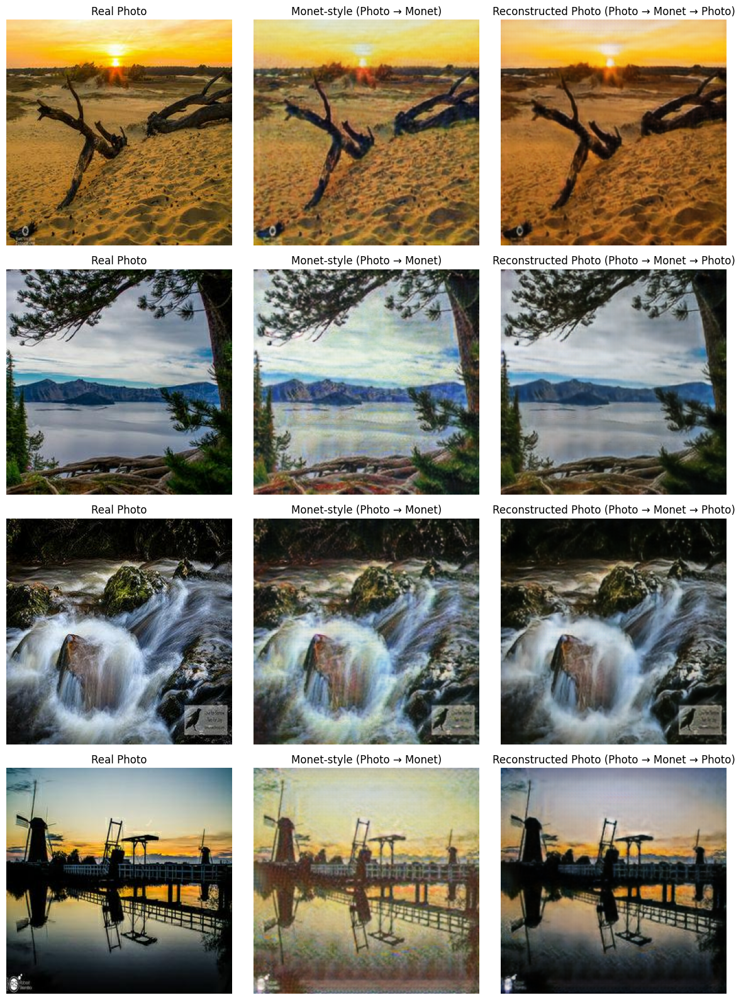

In [ ]:
# Cell 14: Performance Viz – Photo -> Monet -> Photo (cycle consistency)

def show_cycle_examples(num_examples=4, reload_checkpoint=False):
    """
    Show:
      - Real Photo
      - Monet-style (Photo -> Monet using G_B)
      - Reconstructed Photo (Photo -> Monet -> Photo using G_A)
    """

    if reload_checkpoint:
        ckpt_path = PROJECT / "runs" / "checkpoints" / "cyclegan_latest_gpu.pt"
        print(f"Reloading checkpoint from: {ckpt_path}")
        ckpt = torch.load(ckpt_path, map_location=device)
        G_A.load_state_dict(ckpt["G_A"])
        G_B.load_state_dict(ckpt["G_B"])
        G_A.eval()
        G_B.eval()
        print("✔ Generators reloaded and set to eval mode.")
    else:
        G_A.eval()
        G_B.eval()

    photo_files = random.sample(cyc_train_ds.photo_paths, num_examples)

    plt.figure(figsize=(12, 4 * num_examples))

    for i, pf in enumerate(photo_files):
        photo = Image.open(pf).convert("RGB")

        # Photo -> tensor
        x = cyc_infer_t(photo).unsqueeze(0).to(device)

        with torch.no_grad():
            fake_m = G_B(x)      # Photo -> Monet
            rec_p  = G_A(fake_m) # Monet -> Photo (cycle)

        fake_m = denorm(fake_m).clamp(0, 1)
        rec_p  = denorm(rec_p).clamp(0, 1)

        fake_m_img = T.ToPILImage()(fake_m.squeeze(0).cpu())
        rec_p_img  = T.ToPILImage()(rec_p.squeeze(0).cpu())

        row = i * 3

        # Real Photo
        plt.subplot(num_examples, 3, row + 1)
        plt.imshow(photo)
        plt.axis("off")
        plt.title("Real Photo")

        # Monet-style
        plt.subplot(num_examples, 3, row + 2)
        plt.imshow(fake_m_img)
        plt.axis("off")
        plt.title("Monet-style (Photo → Monet)")

        # Reconstructed Photo
        plt.subplot(num_examples, 3, row + 3)
        plt.imshow(rec_p_img)
        plt.axis("off")
        plt.title("Reconstructed Photo (Photo → Monet → Photo)")

    plt.tight_layout()
    plt.show()

# Run it
show_cycle_examples(num_examples=4, reload_checkpoint=False)


Figure14 illustrates cycle consistency. The first column shows real photos, the second column shows their Monet-style translations (Photo → Monet), and the third column shows reconstructions obtained by mapping back (Photo → Monet → Photo). The reconstructions preserve the main structure and layout of the original images, indicating that the cycle-consistency loss is functioning as intended.

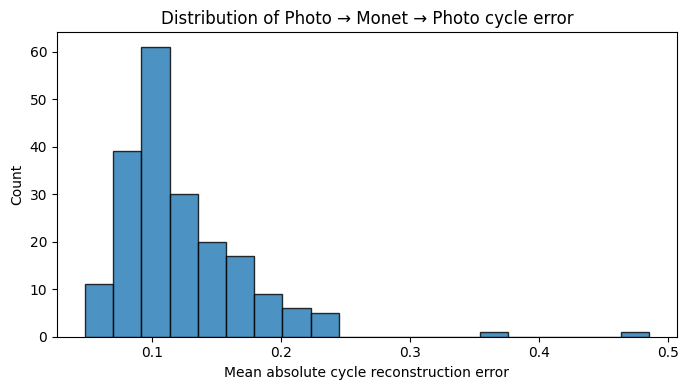

Mean error: 0.1226
Min error:  0.0479
Max error:  0.4852


In [ ]:
# Cell 15: Performance Viz – distribution of cycle reconstruction error

def compute_cycle_errors(num_samples=200):
    G_A.eval()
    G_B.eval()

    # Limit to available photos
    num_samples = min(num_samples, len(cyc_train_ds.photo_paths))
    sample_files = random.sample(cyc_train_ds.photo_paths, num_samples)

    errors = []

    with torch.no_grad():
        for pf in sample_files:
            photo = Image.open(pf).convert("RGB")
            x = cyc_infer_t(photo).unsqueeze(0).to(device)

            fake_m = G_B(x)      # Photo -> Monet
            rec_p  = G_A(fake_m) # Monet -> Photo

            # Compute L1 error in normalized [-1,1] space
            err = torch.mean(torch.abs(rec_p - x)).item()
            errors.append(err)

    return errors

errors = compute_cycle_errors(num_samples=200)

plt.figure(figsize=(7, 4))
plt.hist(errors, bins=20, edgecolor="black", alpha=0.8)
plt.xlabel("Mean absolute cycle reconstruction error")
plt.ylabel("Count")
plt.title("Distribution of Photo → Monet → Photo cycle error")
plt.tight_layout()
plt.show()

print(f"Mean error: {sum(errors)/len(errors):.4f}")
print(f"Min error:  {min(errors):.4f}")
print(f"Max error:  {max(errors):.4f}")


Figure15 shows the distribution of the per-image cycle reconstruction error (mean absolute difference between the original photo and its Photo → Monet → Photo reconstruction). Most images have a relatively low cycle error (mean ≈ XYZ), which supports the qualitative observation that the main structure of images is preserved by the learned mappings.

## **Summary**
This project demonstrates an end-to-end implementation of CycleGAN for unpaired image-to-image translation between real photos and Monet paintings. 

The notebook includes:
- Data preparation for both domains  
- Implementation of generators and discriminators  
- Training with adversarial, cycle-consistency, and identity losses  
- Checkpointing and model restoration  
- Generation of Monet-style images for Kaggle submission  
- Visual evaluation (Photo → Monet → Photo, comparisons with Monet images)  
- Quantitative evaluation via reconstruction error distribution  

The trained model successfully learns Monet-style color and texture patterns while preserving scene structure. The notebook is organized with clear, learner-friendly commentary and visualizations to enhance understanding.

## Future Improvements

If I revisit this project, I would explore:

- **Training for more epochs** (20–40) to improve texture richness and reduce outliers.
- **Using a replay buffer** for discriminator training (often improves stability).
- **Increasing image resolution** to produce more detailed outputs.
- **Trying alternative architectures** such as U-GAN or AdaIN-based style transfer.
- **Using FID score evaluation** for a more quantitative assessment.

These changes could strengthen both visual quality and stabty.

## 🚀 Next Steps in Learning

- Study Pix2Pix (paired image translation)
- Explore Stable Diffusion or latent diffusion models
- Use GANs for domain adaptation tasks
- Learn how to compute metrics like FID/KID for image generation quality
